In [1]:
import matplotlib.colors as mcolors
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from itertools import product
import pandas as pd
import numpy as np
import numba as nb
import imageio
import os
import shutil

randomSeed = 100

%matplotlib inline
%config InlineBackend.figure_format = "svg"

new_cmap = mcolors.LinearSegmentedColormap.from_list(
    "new", plt.cm.hsv(np.linspace(0, 1, 256)) * 0.85, N=256
)

@nb.njit
def colors_idx(phaseTheta):
    return np.floor(256 - phaseTheta / (2 * np.pi) * 256).astype(np.int32)

plt.rcParams['mathtext.fontset'] = 'stix'
plt.rcParams['font.family'] = 'STIXGeneral'

import seaborn as sns

sns.set(font_scale=1.1, rc={
    'figure.figsize': (10, 6),
    'axes.facecolor': 'white',
    'figure.facecolor': 'white',
    'grid.color': '#dddddd',
    'grid.linewidth': 0.5,
    "lines.linewidth": 1.5,
    'text.color': '#000000',
    'figure.titleweight': "bold",
    'xtick.color': '#000000',
    'ytick.color': '#000000'
})

In [2]:
def plot_2d_model(positionX, phaseTheta, xlim, ylim, title, Vs, lens):
    plt.figure()    
    _, ax = plt.subplots(2, 1, figsize=(6, 7), gridspec_kw={'height_ratios': [5, 1.5]})
    scatter = ax[0].scatter(
        positionX[:, 0], positionX[:, 1],
        c=phaseTheta, cmap=new_cmap, alpha=0.8, vmin=0, vmax=2*np.pi, s=3
    )
    cbar = plt.colorbar(scatter, ticks=[0, np.pi, 2 * np.pi])
    cbar.ax.set_ylim(0, 2* np.pi)
    cbar.ax.set_yticklabels(['$0$', '$\pi$', '$2\pi$'])
    # set xlim and ylim at ax
    ax[0].set_xlim(xlim)
    ax[0].set_ylim(ylim)
    ax[0].set_title(title)

    Rs = np.sqrt(positionX[:, 0]**2 + positionX[:, 1]**2)
    V = np.std(Rs, ddof=1) / np.mean(Rs)
    Vs.append(V)
    ax[1].plot(Vs)
    ax[1].set_xlim(0, lens)
    ax[1].set_ylim(0, 0.5)

In [3]:
from ring_main import run_multimodels, run_and_save, RingStatesSwarmalators

In [4]:
Ks = [0, 1, -0.5, -0.05]  # np.linspace(-5, 1, 100)
J1s = np.linspace(-2, 2, 100)
J2s = np.linspace(-2, 2, 100)  # [3]

models = list()
for K, J1, J2 in tqdm(product(Ks, J1s, J2s), total=len(Ks) * len(J1s) * len(J2s)):
    model = RingStatesSwarmalators(agentsNum=100, dt=0.01, K=K, J1=J1, J2=J2)
    models.append(model)

  0%|          | 0/40000 [00:00<?, ?it/s]

In [20]:
run_multimodels(models)

  0%|          | 0/40000 [00:00<?, ?it/s]

In [6]:
def get_V_map_J2(J2: float):
    VMap = pd.DataFrame()
    
    VMap.index.name = "K"
    VMap.columns.name = "J1"

    for K, J1 in tqdm(product(Ks, J1s), total=len(Ks) * len(J1s)):
        data = np.load(f"./data/RingStatesSwarmalators_K{np.round(K, 3)}_J1{np.round(J1, 3)}_J2{np.round(J2, 3)}.npz")
        lastPosition = data["positions"][-1]
        Rs = np.sqrt(lastPosition[:, 0]**2 + lastPosition[:, 1]**2)
        VMap.loc[np.round(K, 3), np.round(J1, 3)] = np.std(Rs, ddof=1) / np.mean(Rs)

    return VMap.sort_index(ascending=False)

def get_V_map_K(K: float):
    VMap = pd.DataFrame()
    
    VMap.index.name = "J1"
    VMap.columns.name = "J2"

    for J1, J2 in tqdm(product(J1s, J2s), total=len(J1s) * len(J2s)):
        data = np.load(f"./data/RingStatesSwarmalators_K{np.round(K, 3)}_J1{np.round(J1, 3)}_J2{np.round(J2, 3)}.npz")
        lastPosition = data["positions"][-1]
        Rs = np.sqrt(lastPosition[:, 0]**2 + lastPosition[:, 1]**2)
        VMap.loc[np.round(J1, 3), np.round(J2, 3)] = np.std(Rs, ddof=1) / np.mean(Rs)

    return VMap.sort_index(ascending=False)

def get_barR_map(J2: float):
    RMap = pd.DataFrame()
    RMap.index.name = "K"
    RMap.columns.name = "J1"

    for K, J1 in tqdm(product(Ks, J1s), total=len(Ks) * len(J1s)):
        data = np.load(f"./data/RingStatesSwarmalators_K{np.round(K, 3)}_J1{np.round(J1, 3)}_J2{np.round(J2, 3)}.npz")
        lastPosition = data["positions"][-1]
        Rs = np.sqrt(lastPosition[:, 0]**2 + lastPosition[:, 1]**2)
        RMap.loc[np.round(K, 3), np.round(J1, 3)] = np.mean(Rs)

    return RMap.sort_index(ascending=False)

def draw_heatmap(map: pd.DataFrame, title: str, vmax: float = 0.5):
    sns.heatmap(map, cmap="viridis", vmin=0, vmax=vmax)
    plt.title(title)
    plt.show()

## V - by K

  0%|          | 0/10000 [00:00<?, ?it/s]

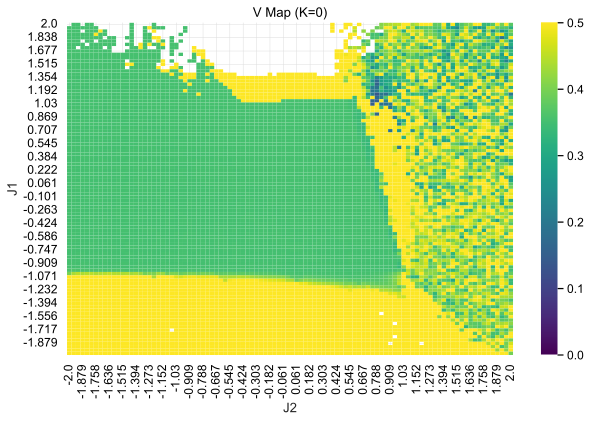

In [ ]:
VMap = get_V_map_K(K=1)
draw_heatmap(VMap, "V Map (K=0)", vmax=0.5)

  0%|          | 0/10000 [00:00<?, ?it/s]

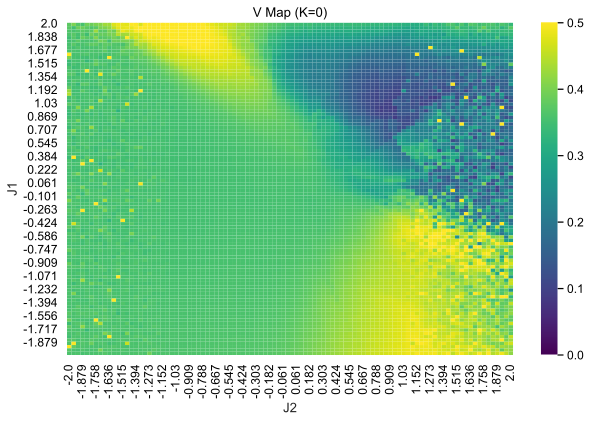

In [7]:
VMap = get_V_map_K(K=0)
draw_heatmap(VMap, "V Map (K=0)", vmax=0.5)

  0%|          | 0/10000 [00:00<?, ?it/s]

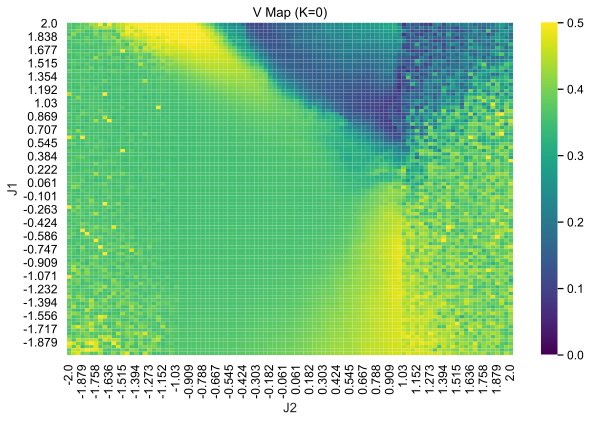

In [9]:
VMap = get_V_map_K(K=-0.05)
draw_heatmap(VMap, "V Map (K=0)", vmax=0.5)

  0%|          | 0/10000 [00:00<?, ?it/s]

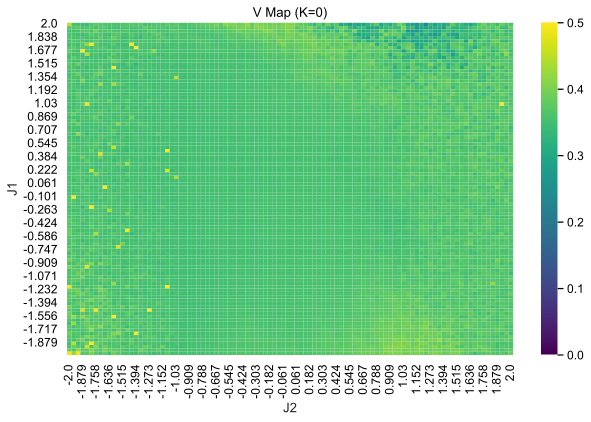

In [8]:
VMap = get_V_map_K(K=-0.5)
draw_heatmap(VMap, "V Map (K=0)", vmax=0.5)

  0%|          | 0/10000 [00:00<?, ?it/s]

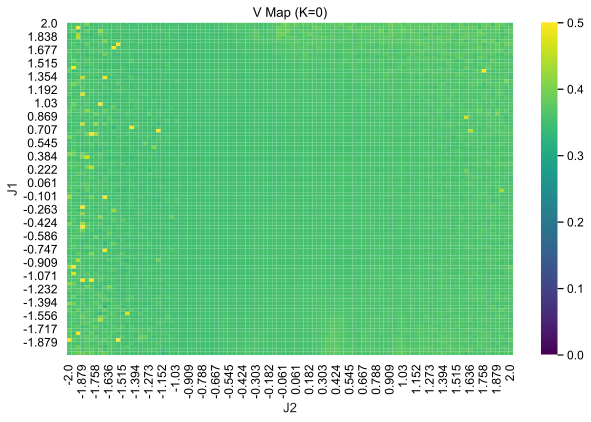

In [18]:
VMap = get_V_map_K(K=-1)
draw_heatmap(VMap, "V Map (K=0)", vmax=0.5)

## V - by J2

  0%|          | 0/10000 [00:00<?, ?it/s]

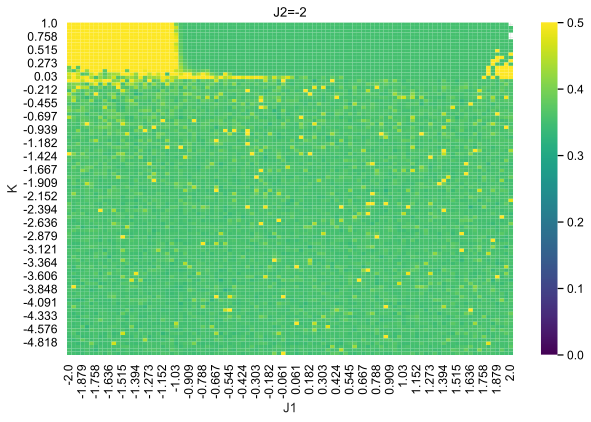

In [32]:
VMap = get_V_map_J2(J2=-2)
draw_heatmap(VMap, "J2=-2")

  0%|          | 0/10000 [00:00<?, ?it/s]

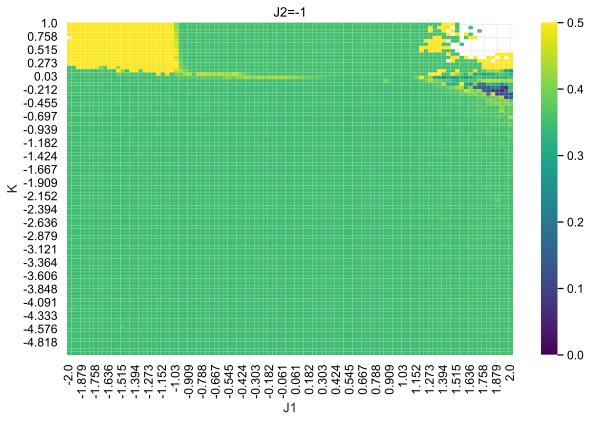

In [33]:
VMap = get_V_map_J2(J2=-1)
draw_heatmap(VMap, "J2=-1")

  0%|          | 0/10000 [00:00<?, ?it/s]

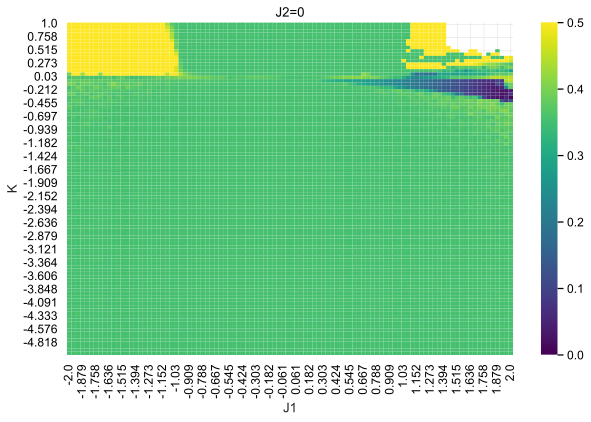

In [27]:
VMap = get_V_map_J2(J2=0)
draw_heatmap(VMap, "J2=0")

  0%|          | 0/10000 [00:00<?, ?it/s]

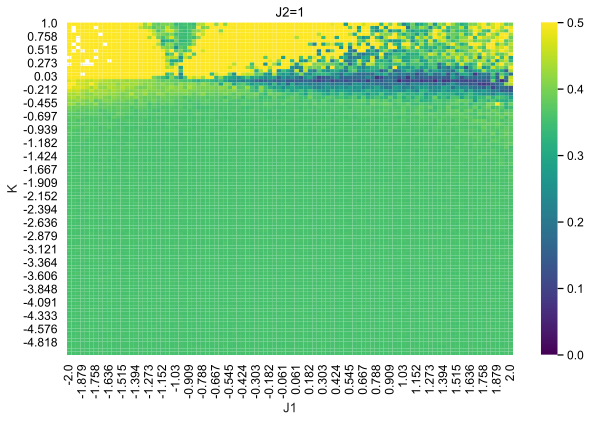

In [28]:
VMap = get_V_map_J2(J2=1)
draw_heatmap(VMap, "J2=1")

  0%|          | 0/10000 [00:00<?, ?it/s]

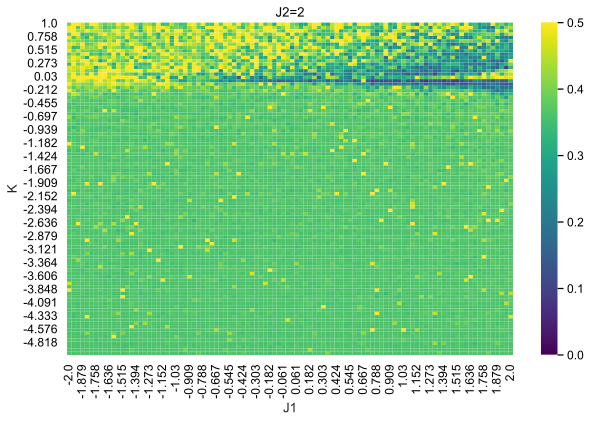

In [31]:
VMap = get_V_map_J2(J2=2)
draw_heatmap(VMap, "J2=2")

  0%|          | 0/10000 [00:00<?, ?it/s]

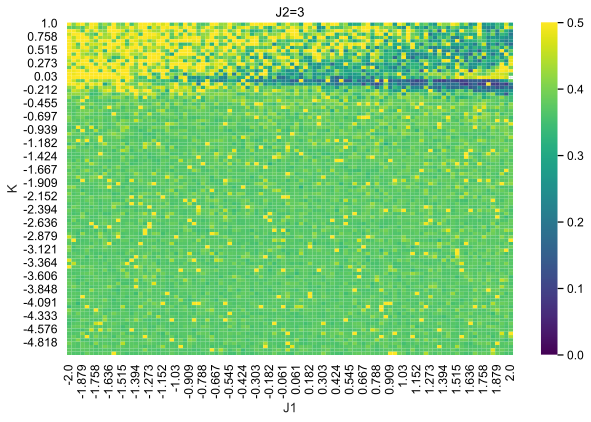

In [36]:
VMap = get_V_map_J2(J2=3)
draw_heatmap(VMap, "J2=3")

## Bar R

  0%|          | 0/10000 [00:00<?, ?it/s]

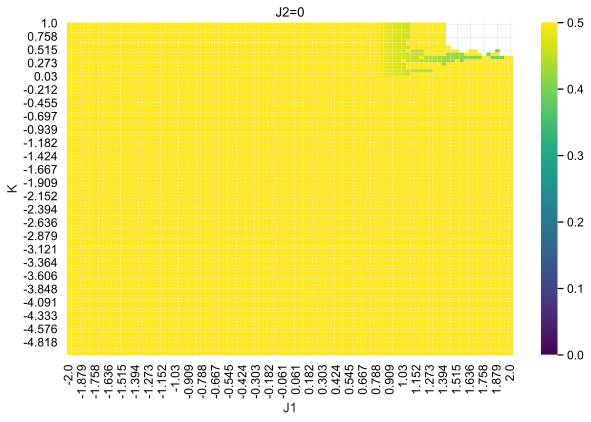

In [45]:
RMap = get_barR_map(J2=0)
draw_heatmap(RMap, "J2=0", vmax=0.5)

  0%|          | 0/10000 [00:00<?, ?it/s]

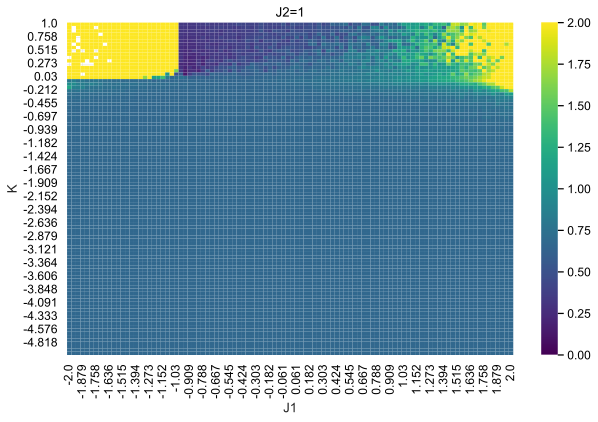

In [46]:
RMap = get_barR_map(J2=1)
draw_heatmap(RMap, "J2=1", vmax=2)

In [20]:
def generate_gif(K: float, J1: float, J2: float):
    data = np.load(f"./data/RingStatesSwarmalators_K{K}_J1{J1}_J2{J2}.npz")
    maxBound = np.max(np.abs(data["positions"]))
    lim = (-maxBound, maxBound)

    if os.path.exists("./images"):
        shutil.rmtree("./images")
    os.mkdir("./images")

    Vs = list()

    for i in tqdm(range(len(data["positions"]))):
        plot_2d_model(data["positions"][i], data["phases"][i], lim, lim, f"K={K}, J1={J1}, J2={J2}, t={i * 0.5}", Vs, len(data["positions"]))
        plt.savefig(f"./images/RingStatesSwarmalators_K{K}_J1{J1}_J2{J2}_{i}.png")
        plt.close()

    images = []
    for i in tqdm(range(len(data["positions"]))):
        images.append(imageio.imread(f"./images/RingStatesSwarmalators_K{K}_J1{J1}_J2{J2}_{i}.png"))
    imageio.mimsave(f"RingStatesSwarmalators_K{K}_J1{J1}_J2{J2}.gif", images)

In [17]:
generate_gif(K=-0.212, J1=1.758, J2=0)

  0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

C:\Users\ThanMark\AppData\Local\Temp\ipykernel_4624\1847953938.py:17: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(f"./images/RingStatesSwarmalators_K{K}_J1{J1}_J2{J2}_{i}.png"))


In [24]:
subK = -0.15

run_and_save(RingStatesSwarmalators(agentsNum=1000, dt=0.1, K=subK, J1=1.5, J2=0))

generate_gif(K=subK, J1=1.5, J2=0)

  0%|          | 0/200 [00:00<?, ?it/s]

C:\Users\ThanMark\AppData\Local\Temp\ipykernel_4624\2564368460.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  _, ax = plt.subplots(2, 1, figsize=(6, 7), gridspec_kw={'height_ratios': [5, 1.5]})
C:\Users\ThanMark\AppData\Local\Temp\ipykernel_4624\2564368460.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


  0%|          | 0/200 [00:00<?, ?it/s]

C:\Users\ThanMark\AppData\Local\Temp\ipykernel_4624\872850394.py:19: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(f"./images/RingStatesSwarmalators_K{K}_J1{J1}_J2{J2}_{i}.png"))


<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

<Figure size 1000x600 with 0 Axes>

In [ ]:
model = RingStatesSwarmalators(agentsNum=100, dt=0.1, K=0.273, J1=-0.99, J2=1)

if os.path.exists("RingPhaseWavesImages"):
    shutil.rmtree("RingPhaseWavesImages")
os.mkdir("RingPhaseWavesImages")

positions = []
phases = []

for i in tqdm(range(1000)):
    model.update()
    if i % 5 == 0:
        positions.append(model.positionX.copy())
        phases.append(model.phaseTheta.copy()) 

xOfPositions = np.array(positions)[:, :, 0]
yOfPositions = np.array(positions)[:, :, 1]
xlim = (np.min(xOfPositions), np.max(xOfPositions))
ylim = (np.min(yOfPositions), np.max(yOfPositions))
images = []

for i, (position, phase) in tqdm(enumerate(zip(positions, phases)), total=len(positions)):
    plot_2d_model(position, phase, xlim, ylim, f"t={i * 0.5}")
    plt.savefig(f"RingPhaseWavesImages/{i}.png", dpi=200)
    plt.close()
    images.append(imageio.imread(f"RingPhaseWavesImages/{i}.png"))

imageio.mimsave("RingPhaseWaves.gif", images, fps=20)

# ffmpeg trans gif to mp4
# os.system("ffmpeg -i RingPhaseWaves.gif RingPhaseWaves.mp4")

In [ ]:
"RingPhaseWaves"
RingStatesSwarmalators(agentsNum=100, dt=0.1, K=-0.003, J1=0, J2=1)

"AnnularPhaseWaves"
RingStatesSwarmalators(agentsNum=2*10**3, dt=0.1, K=0, J1=0.5, J2=1)

"AnnularPhaseWavesJreverse"
RingStatesSwarmalators(agentsNum=2*10**3, dt=0.1, K=0, J1=1, J2=0.5)

"SplinteredPhaseWaves"
RingStatesSwarmalators(agentsNum=1000, dt=0.1, K=-0.05, J1=1.5, J2=0)

"SplinteredPhaseWavesJreverse"
RingStatesSwarmalators(agentsNum=1000, dt=0.1, K=-0.05, J1=0, J2=1.5)

"AnnularPhaseWavesJreverse"
RingStatesSwarmalators(agentsNum=2*10**3, dt=0.1, K=0, J1=1, J2=0.5)

"HopfBifurcation"
RingStatesSwarmalators(agentsNum=1000, dt=0.1, K=-3.4, J1=1.7, J2=0)

In [18]:
os.system("ffmpeg -i AnnularPhaseWaves.gif AnnularPhaseWaves.mp4")

0

In [43]:
name = "test"
model = RingStatesSwarmalators(agentsNum=1000, dt=0.1, K=0.273, J1=-0.99, J2=1)

if os.path.exists(f"{name}Images"):
    shutil.rmtree(f"{name}Images")
os.mkdir(f"{name}Images")

positions = []
phases = []

for i in tqdm(range(1000)):
    model.update()
    if i % 5 == 0:
        positions.append(model.positionX.copy())
        phases.append(model.phaseTheta.copy()) 

xOfPositions = np.array(positions)[:, :, 0]
yOfPositions = np.array(positions)[:, :, 1]
# xlim = ylim = (-5, 5)
xlim = (np.min(xOfPositions), np.max(xOfPositions))
ylim = (np.min(yOfPositions), np.max(yOfPositions))
images = []

for i, (position, phase) in tqdm(enumerate(zip(positions, phases)), total=len(positions)):
    plot_2d_model(position, phase, xlim, ylim, f"t={i * 0.5}")
    plt.savefig(f"{name}Images/{i}.png", dpi=200)
    plt.close()
    images.append(imageio.imread(f"{name}Images/{i}.png"))

imageio.mimsave(f"{name}.gif", images, fps=20)

# ffmpeg trans gif to mp4
if os.path.exists(f"{name}.mp4"):
    os.remove(f"{name}.mp4")
os.system(f"ffmpeg -i {name}.gif {name}.mp4")

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/200 [00:00<?, ?it/s]

0

In [50]:
for _ in tqdm(range(100)):
    model.update()

  0%|          | 0/100 [00:00<?, ?it/s]

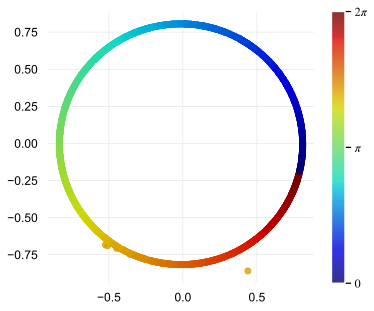

In [51]:
model.plot()